# Step 1 Import all essential libraries

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import pickle
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline
print("Step 1 Complete - All Libraries Imported")

Step 1 Complete - All Libraries Imported


# Step 2 Setup for Camera Calibration

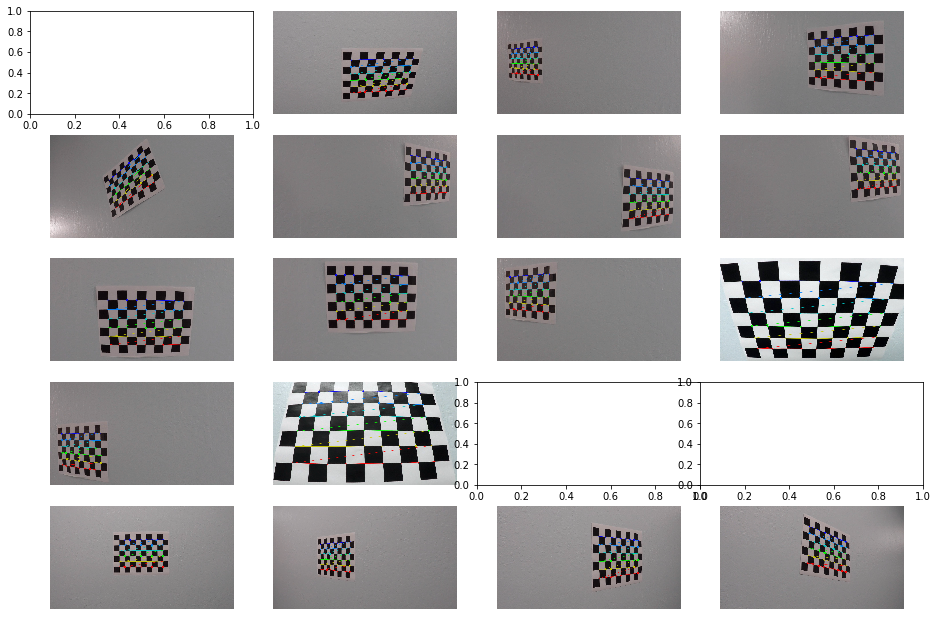

In [2]:
# Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Termination criteria used 
# Reference: http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_calib3d/py_calibration/py_calibration.html
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners - The tweak here is to use the chess board corners as (9, 6) instead of (8, 6) in lessons
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        # Improve accuracy of corners Reference: http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_calib3d/py_calibration/py_calibration.html
        accurate_corners = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        imgpoints.append(accurate_corners)

        # Draw and display the corners. Adjust drawing of chessboard corners to (9,6)
        cv2.drawChessboardCorners(img, (9,6), accurate_corners, ret)
        axs[idx].axis('off')
        axs[idx].imshow(img)
#         cv2.imshow('img',img) #Does not work
#         write_name = 'corners_found'+str(idx)+'.jpg'
#         cv2.imwrite(write_name, img)

## Step 3 Find Camera Matrix, Distortion Co-efficients and Test Undistortion on images

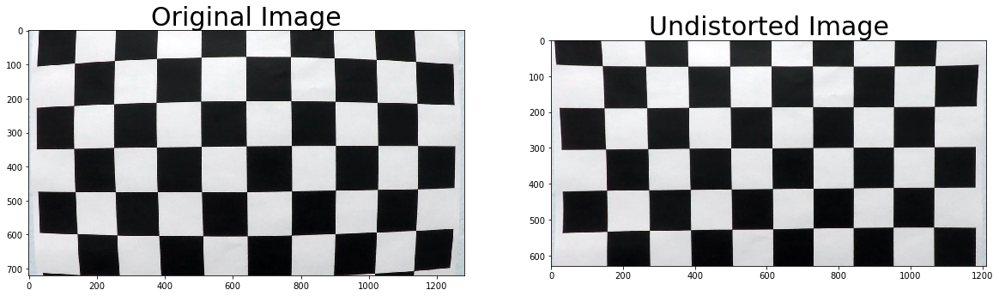

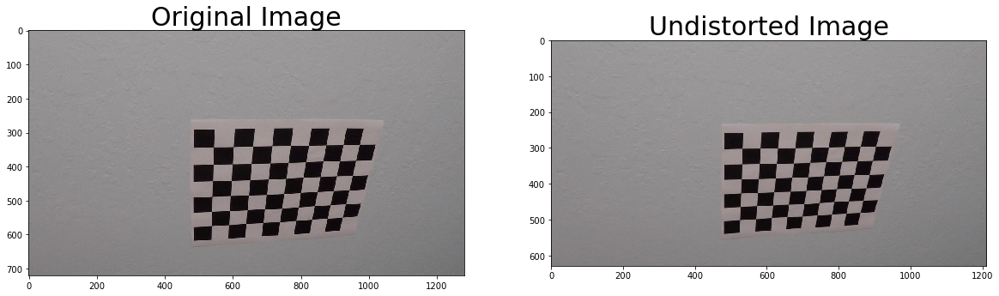

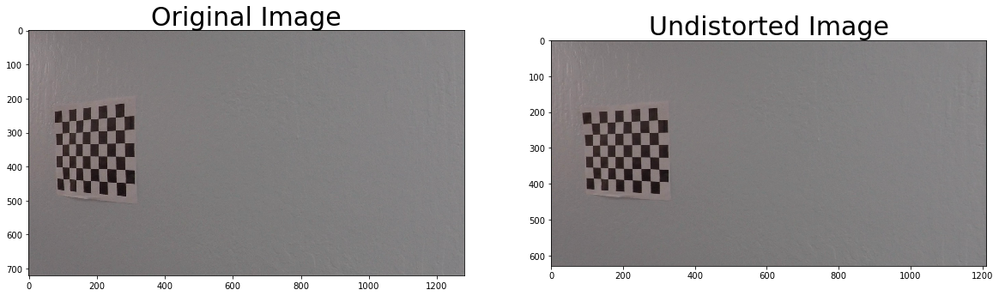

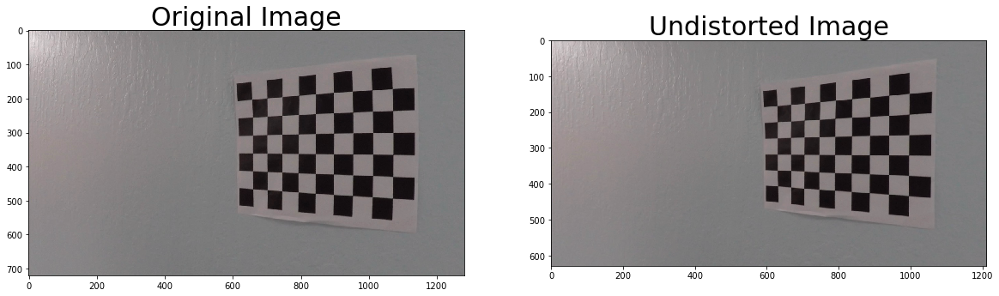

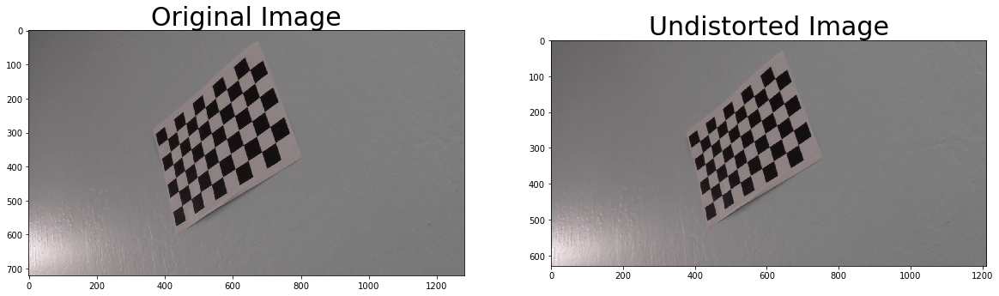

...

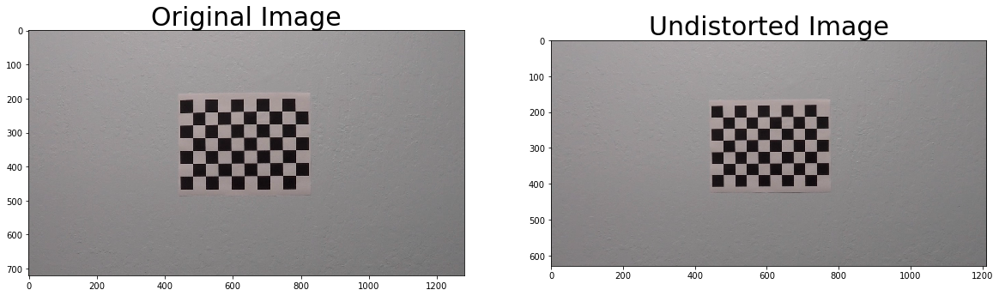

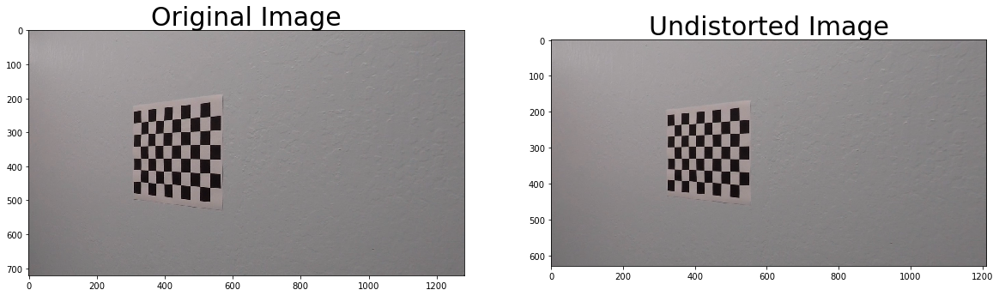

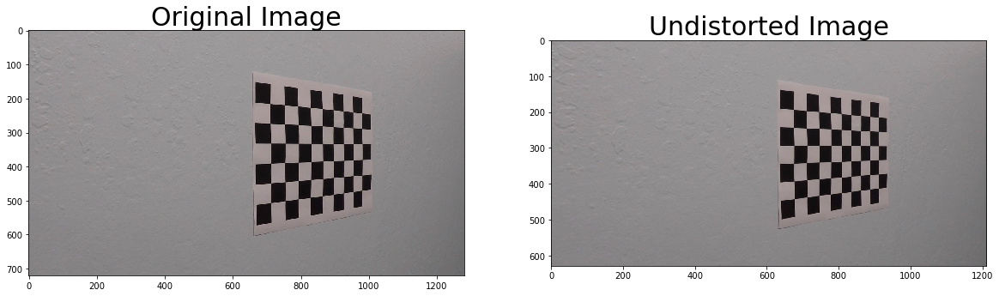

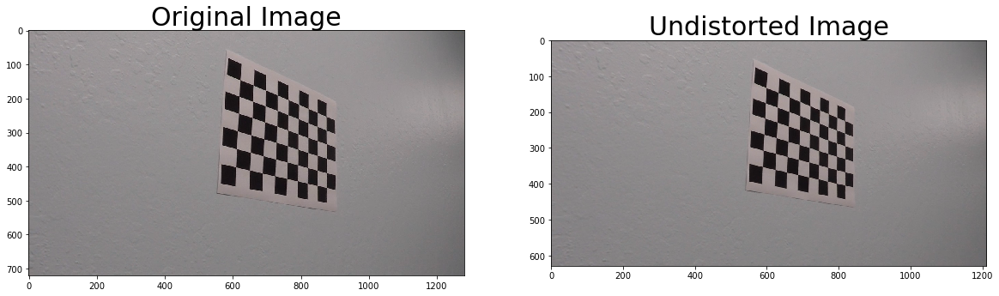

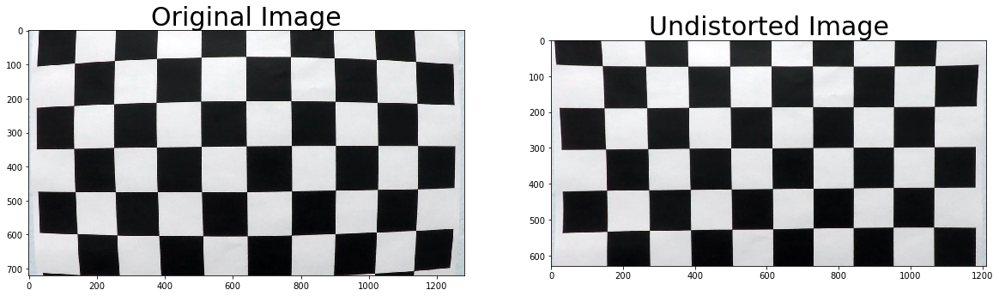

In [3]:
# The technique learnt in the lesson have been applied to all images
# Initialize pickle dictionary - Use for pickle dump
dist_pickle = {}
for idx, fname in enumerate(images):
    # Read each image to undistort
    img = cv2.imread(fname)
    
    #Identify the dimensions
    img_size = (img.shape[1], img.shape[0])
    
    
    #Calibrate camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    
    #Undistort images
    #Step 1- Get Optimal New Camera Matrix
    h, w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
    #dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    #Step 2a- Undistort image shortest path
    #dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
    
    #Step 2b - Undistort image curved path
    mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
    dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)
        
    # Step 3b - Crop image 
    x,y,w,h = roi
    dst = dst[y:y+h, x:x+w]
#     cv2.imwrite('calibresult.png',dst)
    
    #Create a dictionary to dump undistorted image data into a pickle file
#     dist_pickle["mtx"] = mtx
#     dist_pickle["dist"] = dist
    # Correct Functionality for Pickle Dump
    dist_pickle[fname] = mtx
    dist_pickle[fname+"_dist"] = dist
    #dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)

    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)

#Dump all undistorted images into a pickle file
pickle.dump(dist_pickle, open( "calibration.p", "wb" ))

# Pickle single image calibration for testing purposes
# Test undistortion on an image from Camera Calibration Images folder
img = cv2.imread('./camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

h, w = img.shape[:2]
newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
# Undistort image - without Optimal new camera matrix
# dst = cv2.undistort(img, mtx, dist, None, mtx)
# Undistort image - with Optimal new camera matrix
# dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
# cv2.imwrite('./camera_cal/calibration1_undist.jpg',dst)

#Step 2b - Undistort image curved path
mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

x,y,w,h = roi
dst = dst[y:y+h, x:x+w]
cv2.imwrite('calibresult.png',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration1.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

## Step 4 Applying Undistortion To Input Images

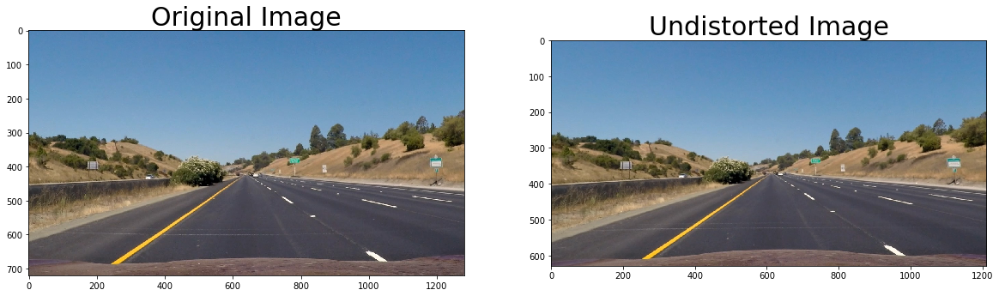

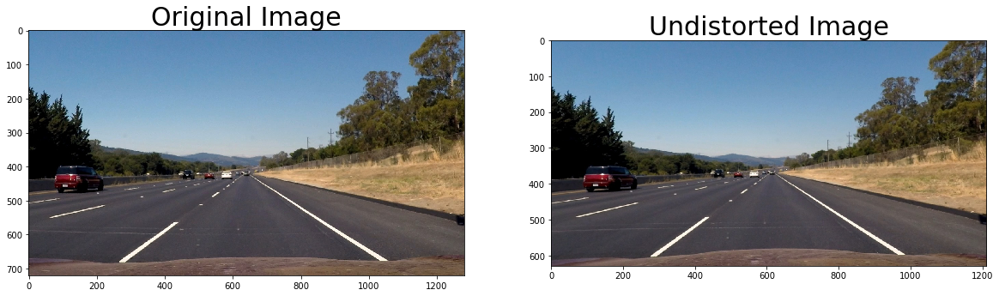

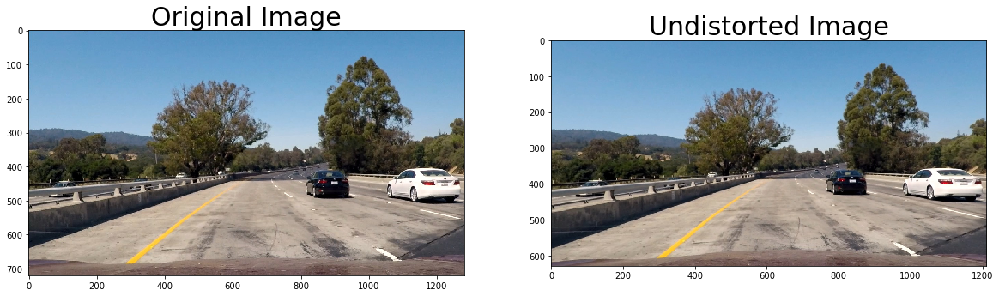

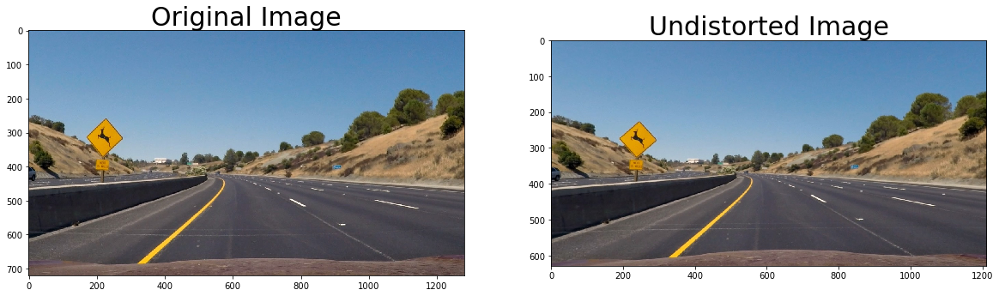

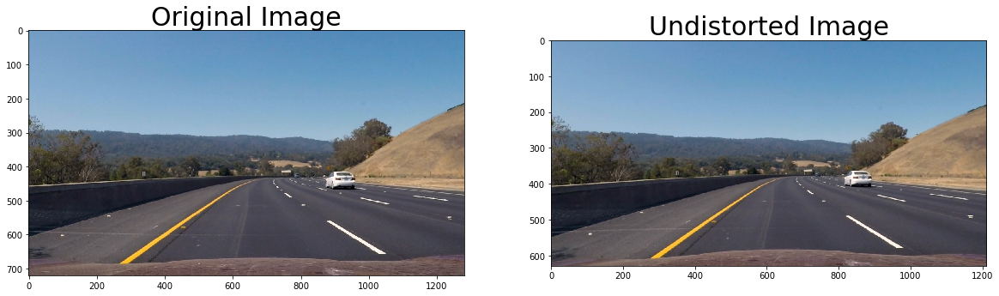

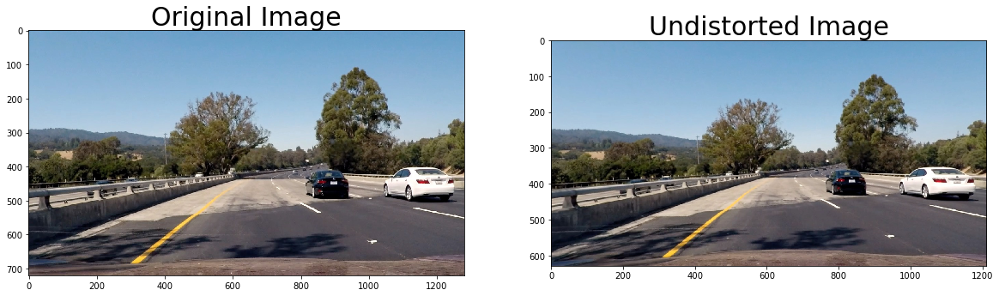

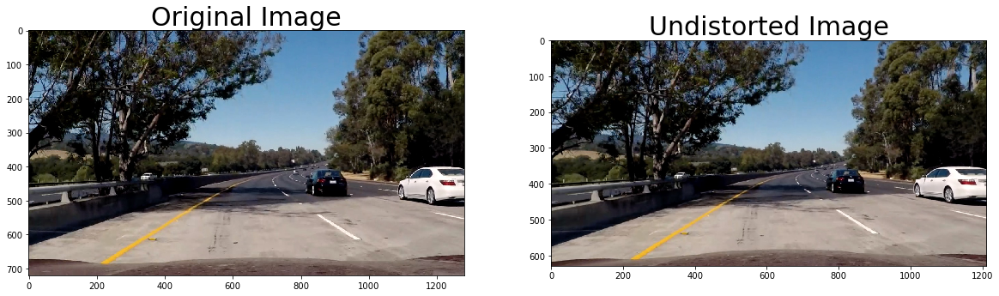

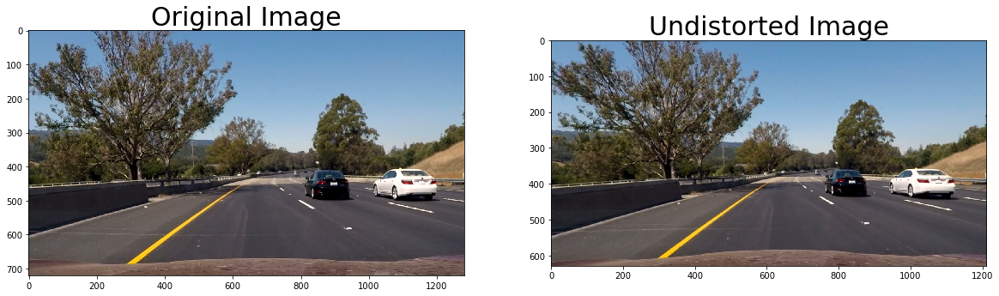

In [4]:
# Using Undistort approach for curved path instead of shortest path.
# Reference: http://docs.opencv.org/3.0-beta/doc/py_tutorials/py_calib3d/py_calibration/py_calibration.html
def undistort_image(img):
    h, w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
    mapx,mapy = cv2.initUndistortRectifyMap(mtx,dist,None,newcameramtx,(w,h),5)
    dst = cv2.remap(img,mapx,mapy,cv2.INTER_LINEAR)

    x,y,w,h = roi
    undist_img = dst[y:y+h, x:x+w]
    return undist_img

test_images = glob.glob('./test_images/*.jpg')
for idx, fname in enumerate(test_images):
    test_image = cv2.imread(fname)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
    undist_image = undistort_image(test_image)    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist_image)
    ax2.set_title('Undistorted Image', fontsize=30)
    #Saving Undistorted Images for next step of processing
    cv2.imwrite('./output_images/test'+str(idx)+'_undist.jpg',undist_image)

## Step 5 Applying Perspective Transform

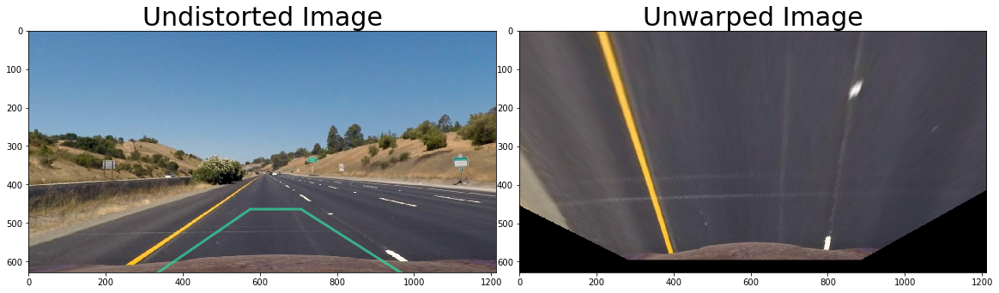

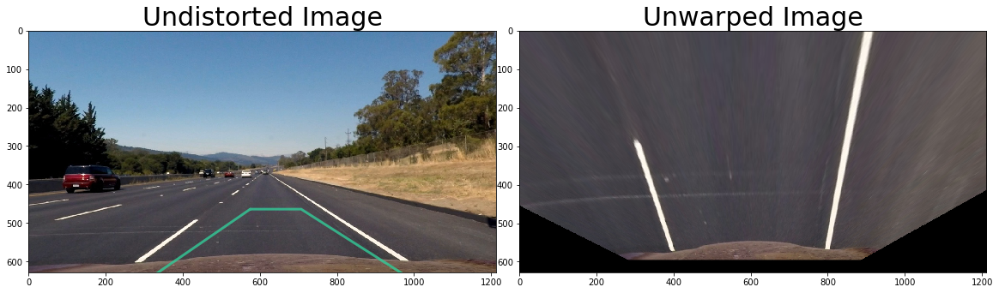

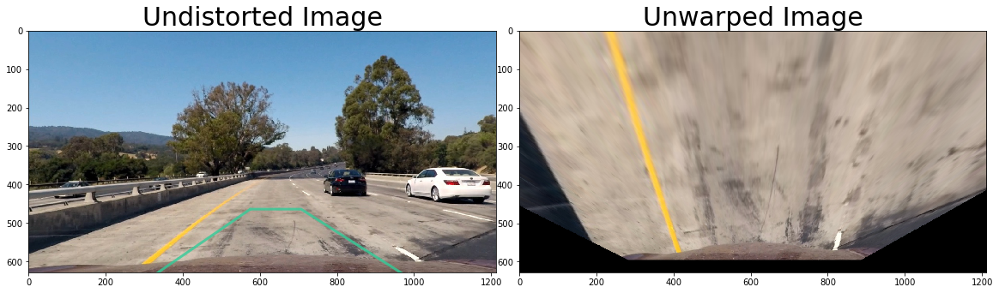

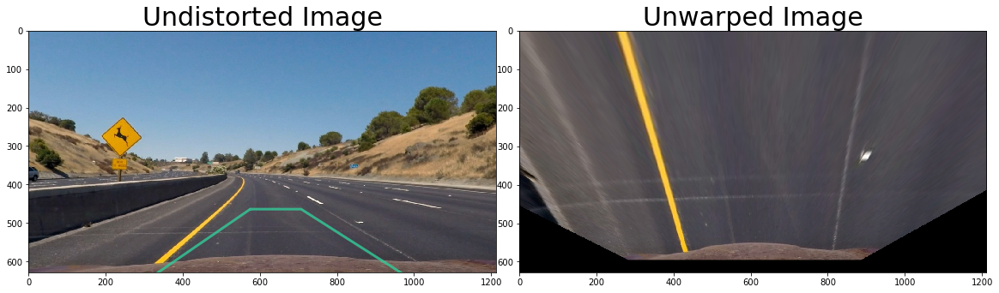

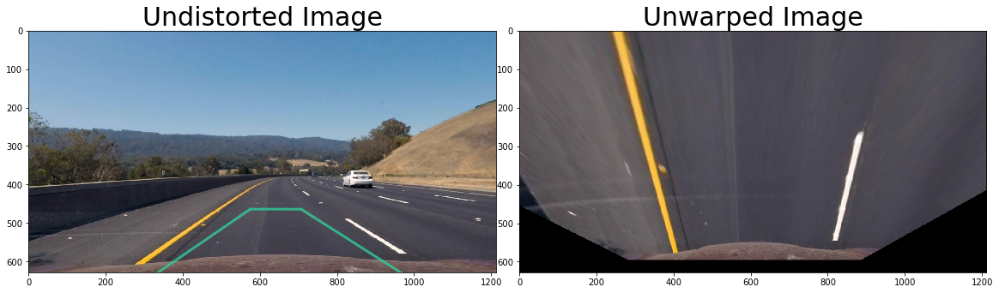

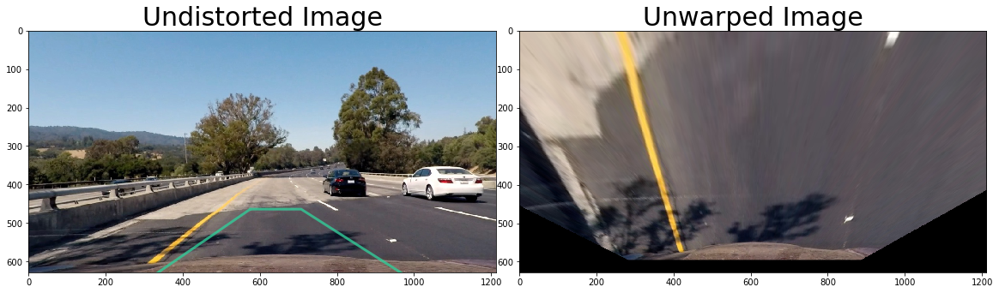

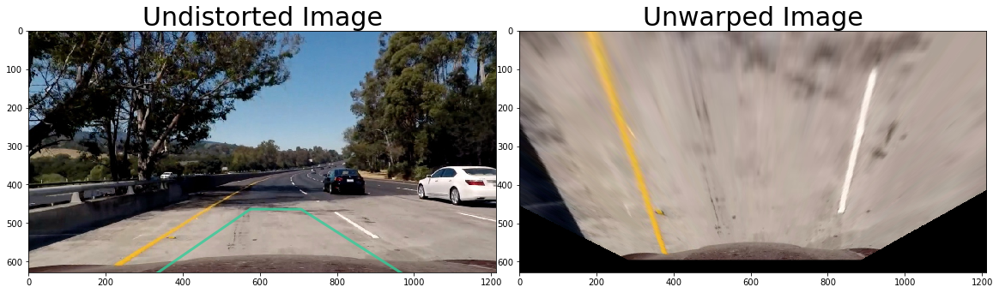

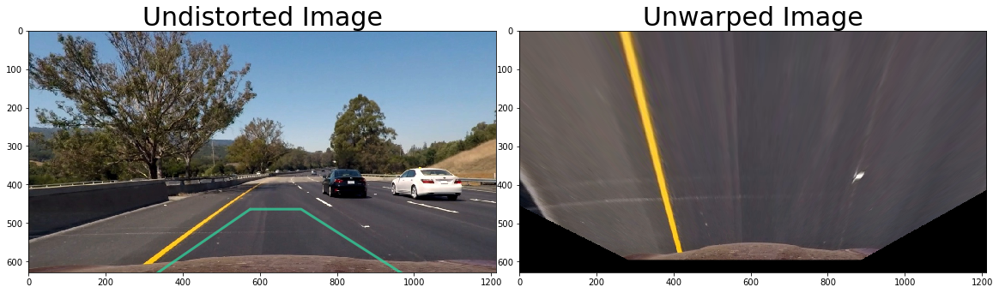

In [5]:
def warp_image(img, src, dst):
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    #h, w = img.shape[:2]
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)  # keep same size as input image    
    #warped = cv2.warpPerspective(img, M, (h, w), flags=cv2.INTER_LINEAR)  # keep same size as input image    
    return warped, M, Minv

def find_polygon(xsize, ysize):
    point1 = (int(xsize*0.11),int(ysize))
    #print(point1)
    point2 = (int(xsize*0.44),int(ysize*0.60))
    #print(point2)
    point3 = (int(xsize*0.57),int(ysize*0.60))
    #print(point3)
    point4 = (int(xsize*0.97),int(ysize))
    #print(point4)
    return([point1,point2,point3,point4])

# define source and destination points for transform
src = np.float32([(575,464),
                  (707,464), 
                  (258,682), 
                  (1049,682)])

undistort_test_images = glob.glob('./output_images/test*_undist.jpg')
for idx, fname in enumerate(undistort_test_images):
    undist_image = cv2.imread(fname)
    h,w = undist_image.shape[:2]
    #print("Height and Width:"+str(h)+","+str(w))
    #print("Image Size:"+str(undist_image[1])+","+str(undist_image[0]))
    
    dst = np.float32([(450,0),
                  (w-450,0),
                  (450,h),
                  (w-450,h)])
    unwarped_image, M, Minv = warp_image(undist_image, src, dst)

    # Visualize unwarp
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(undist_image)
    
    #Draw Quadrilateral on the original undistorted image for painting lanes in pipeline
    #vertices = find_polygon(h, w)
#     x = [vertices[0][0],vertices[2][0],vertices[3][0],vertices[1][0],vertices[0][0]]
#     y = [vertices[0][1],vertices[2][1],vertices[3][1],vertices[1][1],vertices[0][1]]
#     print('Vertices X:',x)
#     print('Vertices Y:',y)    
    x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
    y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
#     print('Vertices X:',x)
#     print('Vertices Y:',y)    

    #Draw Quadrilateral
    ax1.plot(x, y, color='#33cc99', alpha=0.8, linewidth=3, solid_capstyle='round', zorder=2)
    ax1.set_ylim([h,0])
    ax1.set_xlim([0,w])
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(unwarped_image)
    ax2.set_title('Unwarped Image', fontsize=30)
    cv2.imwrite('./output_images/warp/test_unwarp'+str(idx)+'.jpg', unwarped_image)

## Step 6 Explore Color Channels

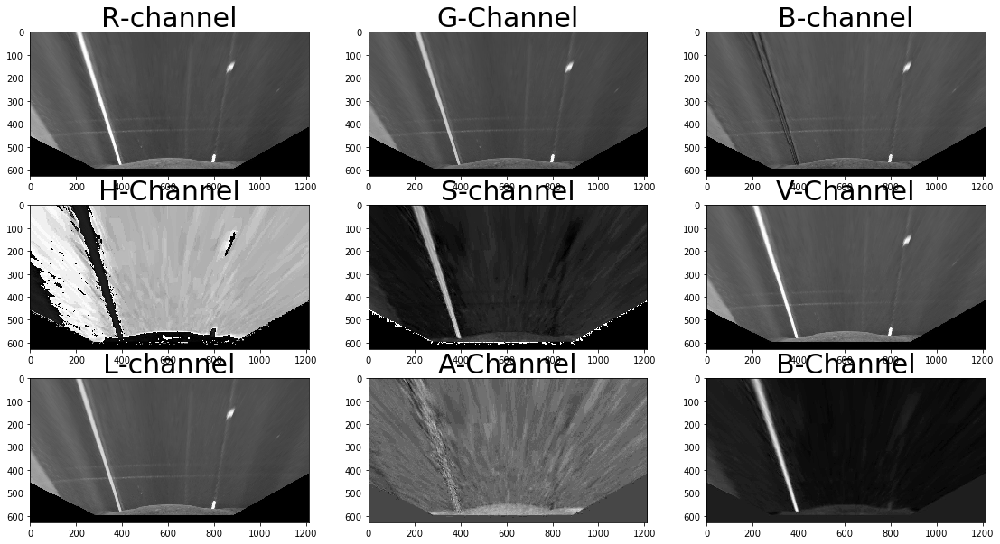

In [6]:
unwarp_image_check = cv2.imread('./output_images/warp/test_unwarp0.jpg')
# Explore RGB Color Channels
unwarp_image_check_R = unwarp_image_check[:,:,0]
unwarp_image_check_G = unwarp_image_check[:,:,1]
unwarp_image_check_B = unwarp_image_check[:,:,2]

#Explore HSV channel
unwarp_image_check_HSV = cv2.cvtColor(unwarp_image_check, cv2.COLOR_RGB2HSV)
unwarp_image_check_H   = unwarp_image_check_HSV[:,:,0]
unwarp_image_check_S   = unwarp_image_check_HSV[:,:,1]
unwarp_image_check_V   = unwarp_image_check_HSV[:,:,2]

#Explore Lab Channel
unwarp_image_check_LAB = cv2.cvtColor(unwarp_image_check, cv2.COLOR_RGB2Lab)
unwarp_image_check_L   = unwarp_image_check_LAB[:,:,0]
unwarp_image_check_A   = unwarp_image_check_LAB[:,:,1]
unwarp_image_check_B2  = unwarp_image_check_LAB[:,:,2]

fig, axs = plt.subplots(3,3, figsize=(20,10))
fig.subplots_adjust(hspace = .2, wspace=.02)
axs = axs.ravel()
axs[0].imshow(unwarp_image_check_R, cmap='gray')
axs[0].set_title('R-channel', fontsize=30)
axs[1].imshow(unwarp_image_check_G, cmap='gray')
axs[1].set_title('G-Channel', fontsize=30)
axs[2].imshow(unwarp_image_check_B, cmap='gray')
axs[2].set_title('B-channel', fontsize=30)
axs[3].imshow(unwarp_image_check_H, cmap='gray')
axs[3].set_title('H-Channel', fontsize=30)
axs[4].imshow(unwarp_image_check_S, cmap='gray')
axs[4].set_title('S-channel', fontsize=30)
axs[5].imshow(unwarp_image_check_V, cmap='gray')
axs[5].set_title('V-Channel', fontsize=30)
axs[6].imshow(unwarp_image_check_L, cmap='gray')
axs[6].set_title('L-channel', fontsize=30)
axs[7].imshow(unwarp_image_check_A, cmap='gray')
axs[7].set_title('A-Channel', fontsize=30)
axs[8].imshow(unwarp_image_check_B2, cmap='gray')
axs[8].set_title('B-Channel', fontsize=30)

## Step 7 Testing thresholds - Absolute, Magnitude, Direction and Color

In [7]:
def abs_sobel_thresh(img, orient='x', kernel_size=3, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) #Convert to gray scale
    #Call Sobel filter based on the orientation
    if orient == 'x': 
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    elif orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    #Get the absolute value of Sobel filter
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(abs_sobel / np.max(abs_sobel) * 255)
    abs_threshold = np.zeros_like(scaled_sobel)
    abs_threshold[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return abs_threshold


def mag_thresh(img, kernel_size=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gradx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    grady = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    magnitude = np.sqrt(np.power(gradx, 2) + np.power(grady, 2))
    scaled_magnitude = np.uint8(255 * magnitude / np.max(magnitude))
    magnitude_threshold = np.zeros_like(scaled_magnitude)
    magnitude_threshold[(scaled_magnitude > mag_thresh[0]) & (scaled_magnitude < mag_thresh[1])] = 1
    return magnitude_threshold


def dir_threshold(img, kernel_size=3, thresh=(0, np.pi / 2)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gradx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel_size)
    grady = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel_size)
    abs_x = np.abs(gradx)
    abs_y = np.abs(grady)
    direction_threshold = np.arctan2(abs_y, abs_x)
    binary_output = np.zeros_like(direction_threshold)
    binary_output[(direction_threshold >= thresh[0]) & (direction_threshold <= thresh[1])] = 1
    return binary_output


def hls_select(image, thresh=(90, 255)):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    S = hsv[:, :, 2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary


def lab_select(image, thresh=(90, 255)):
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    B = lab[:, :, 2]
    binary = np.zeros_like(B)
    binary[(B > thresh[0]) & (B <= thresh[1])] = 1
    return binary


def combined(image):
    ksize = 3
    s_thresh = hls_select(image, thresh=(100, 255))
    b_thresh = lab_select(image, thresh=(190, 255))

    gradx = abs_sobel_thresh(image, orient='x', kernel_size=ksize, thresh=(15, 210))
    grady = abs_sobel_thresh(image, orient='y', kernel_size=ksize, thresh=(15, 210))
    dir_binary = dir_threshold(image, kernel_size=15, thresh=(0.7, 1.2))
    mag_binary = mag_thresh(image, kernel_size=9, mag_thresh=(50, 200))
    combined = np.zeros_like(dir_binary)

    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | (s_thresh == 1) | (b_thresh == 1)] = 1

    return combined

## Test Absolute Gradient

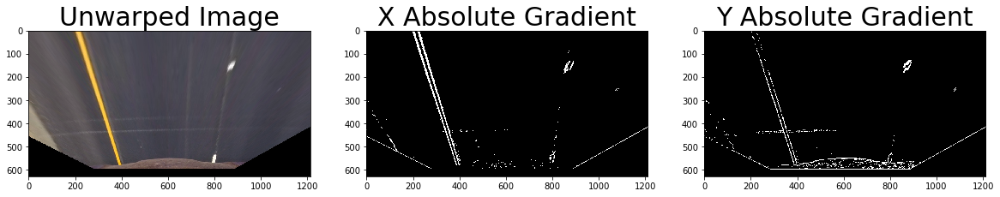

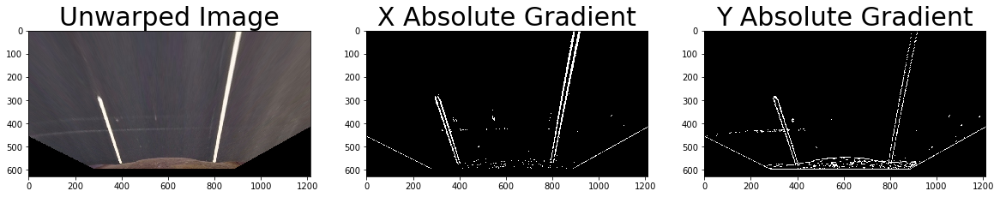

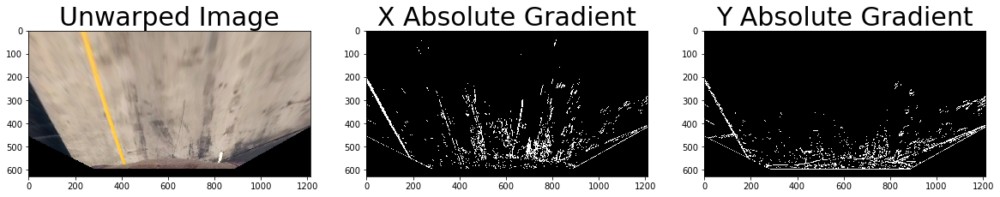

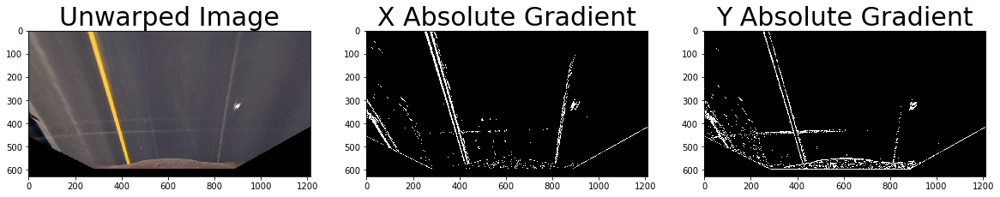

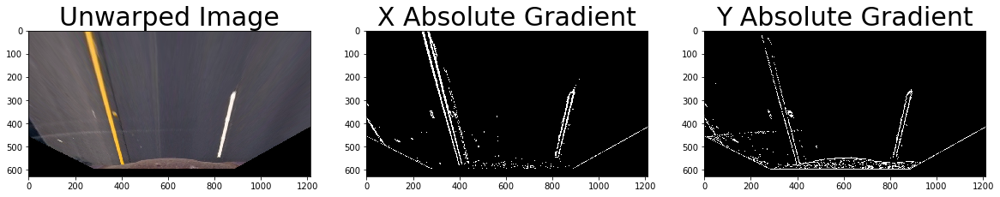

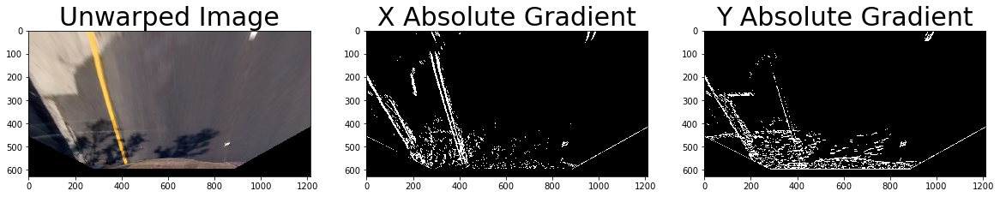

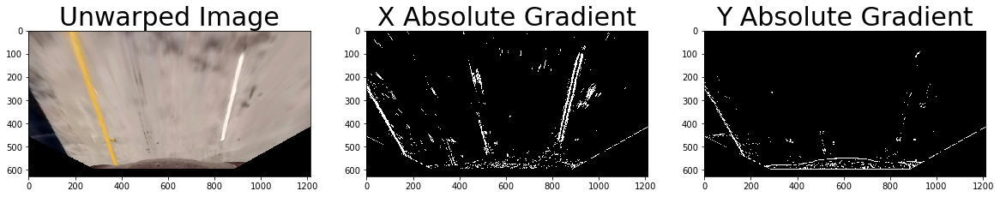

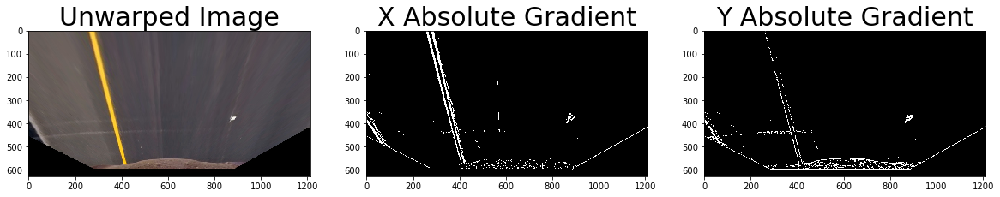

In [8]:
unwarped_test_images = glob.glob('./output_images/warp/*.jpg')

for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    grad_binary_x = abs_sobel_thresh(unwarp_image, orient='x', kernel_size=3, thresh=(15, 210))
    grad_binary_y = abs_sobel_thresh(unwarp_image, orient='y', kernel_size=3, thresh=(15, 210))
    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(grad_binary_x, cmap='gray')
    ax2.set_title('X Absolute Gradient', fontsize=30)
    ax3.imshow(grad_binary_y, cmap='gray')
    ax3.set_title('Y Absolute Gradient', fontsize=30)

## Test Sobel Magnitude Threshold

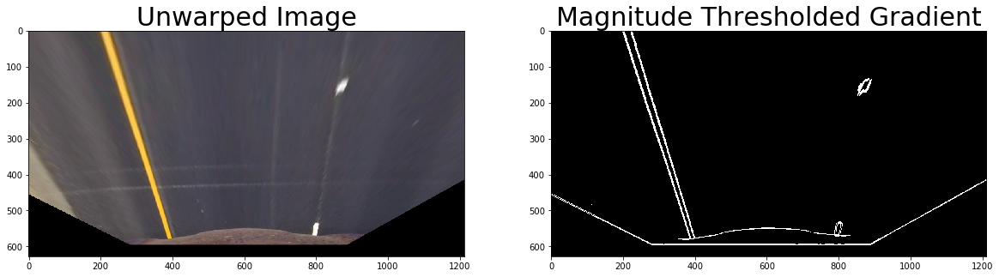

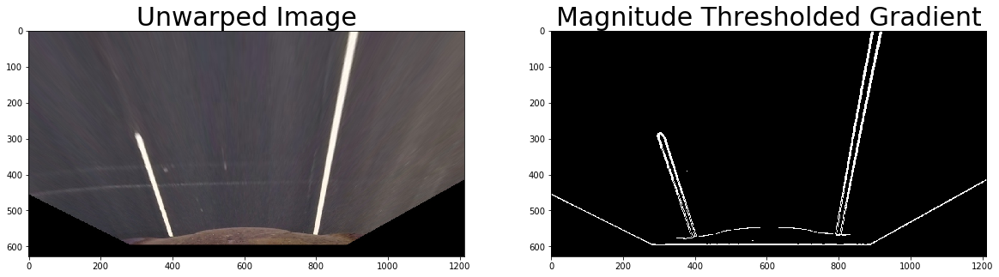

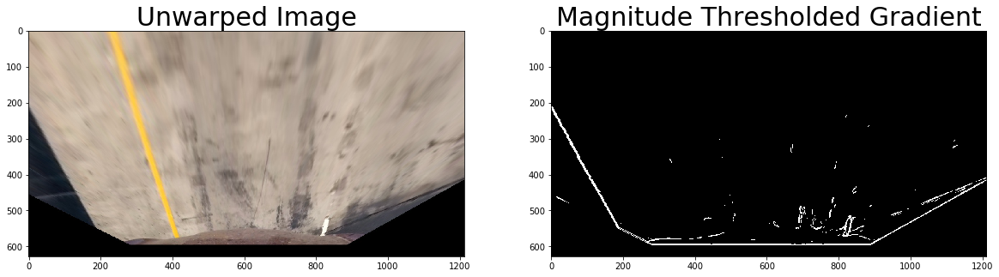

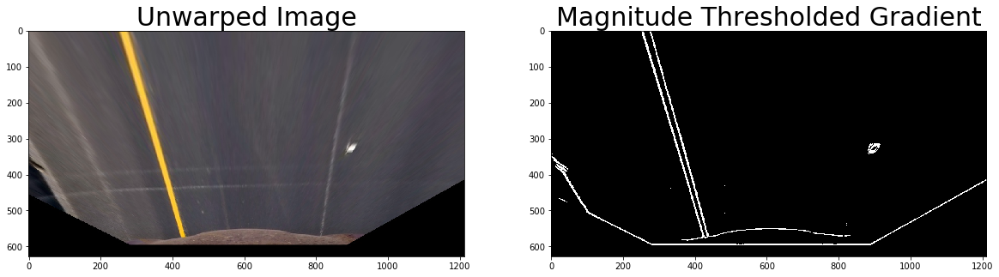

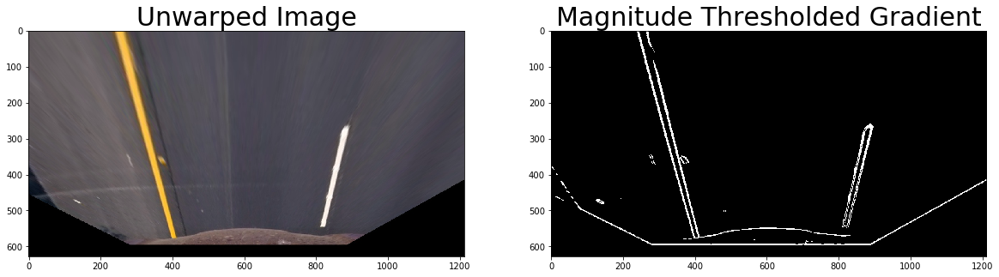

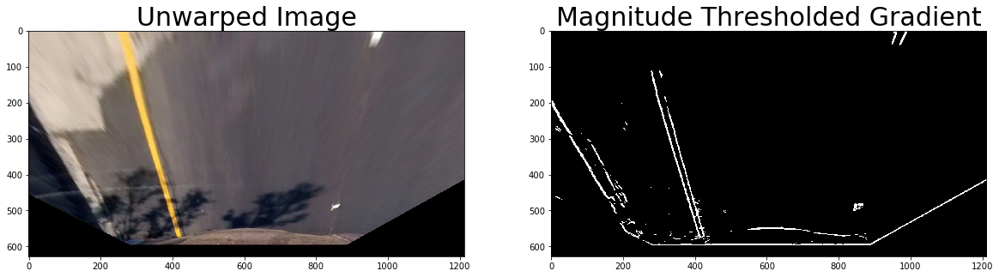

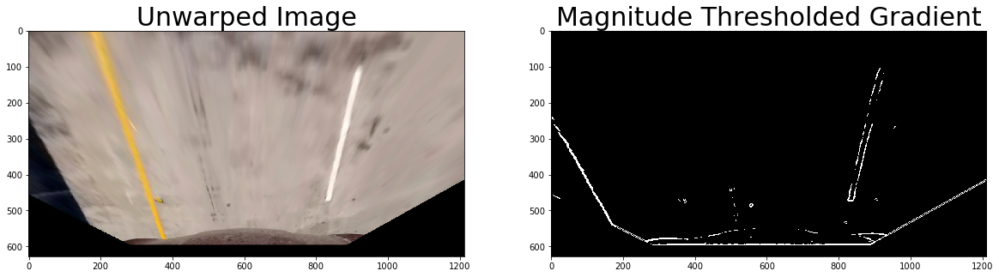

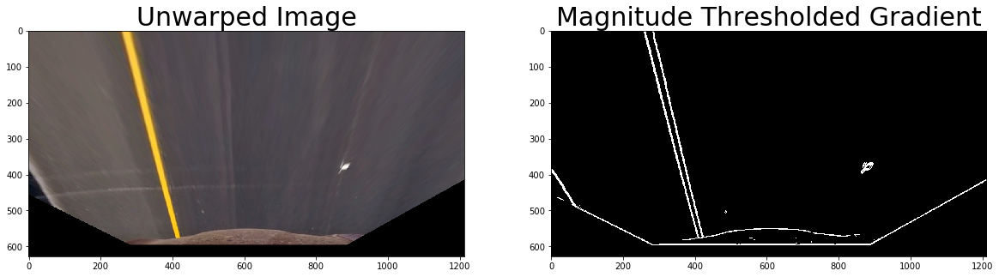

In [9]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    mag_binary = mag_thresh(unwarp_image, kernel_size=9, mag_thresh=(50, 200))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(mag_binary, cmap='gray')
    ax2.set_title('Magnitude Thresholded Gradient', fontsize=30)

## Test Direction Threshold

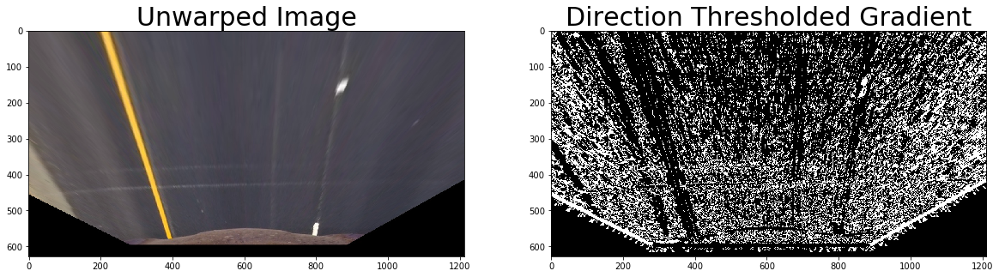

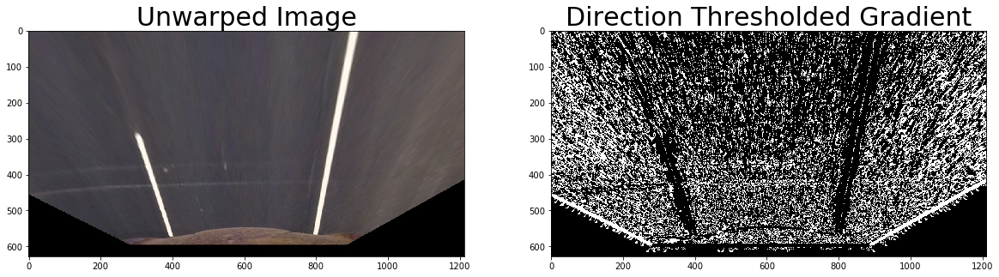

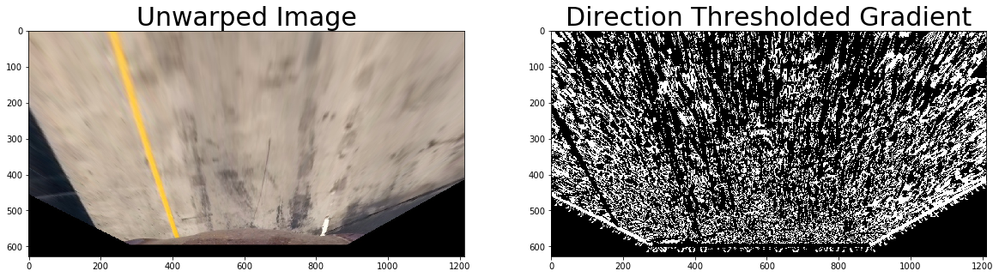

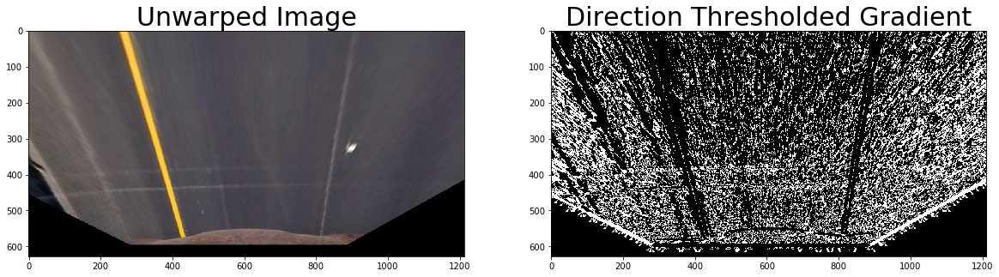

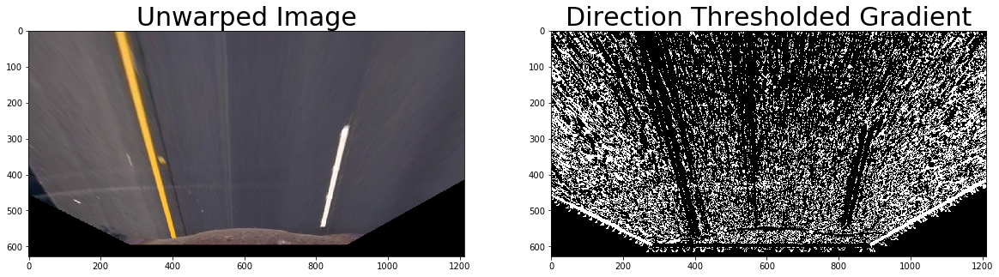

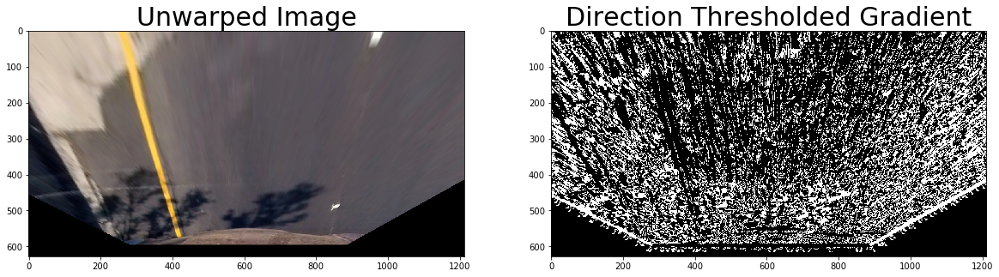

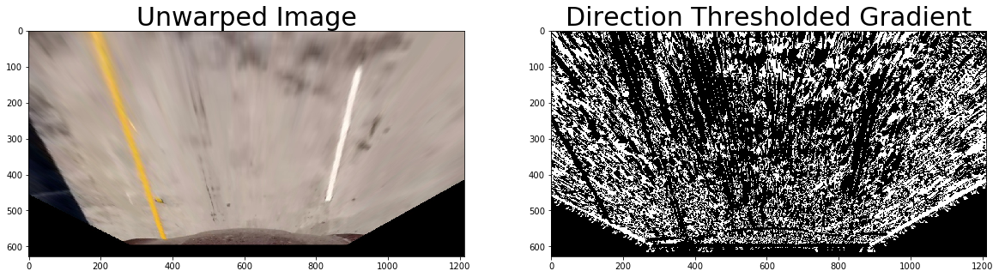

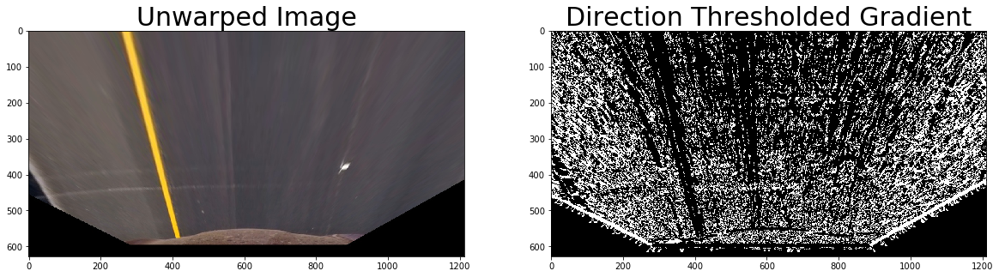

In [10]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    dir_binary = dir_threshold(unwarp_image, kernel_size=15, thresh=(0.7, 1.3))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(dir_binary, cmap='gray')
    ax2.set_title('Direction Thresholded Gradient', fontsize=30)

## Test Color S Channel Threshold

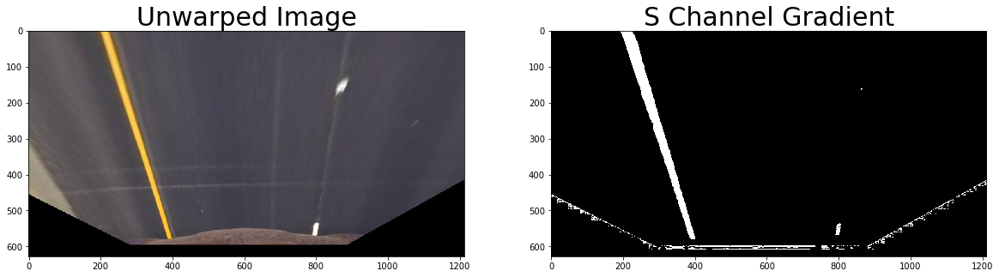

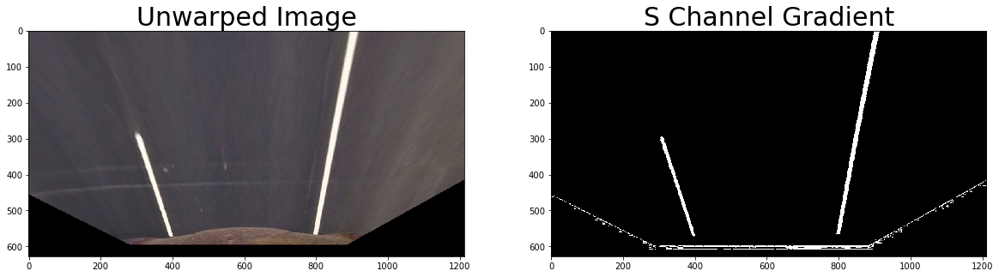

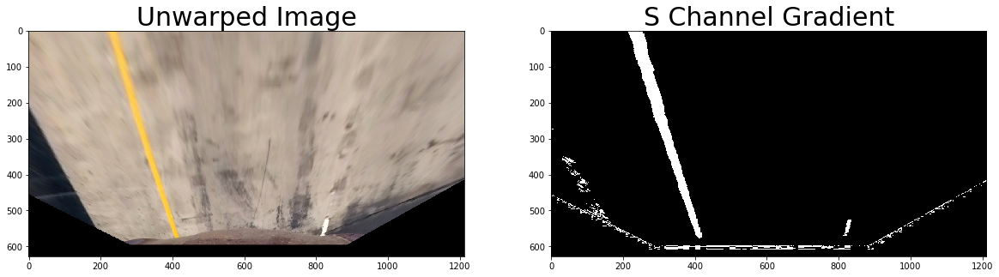

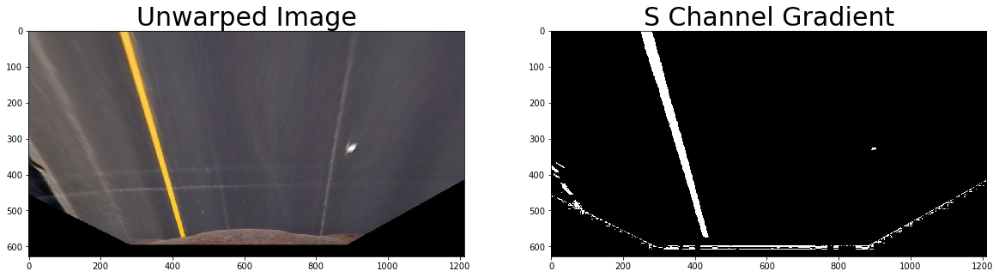

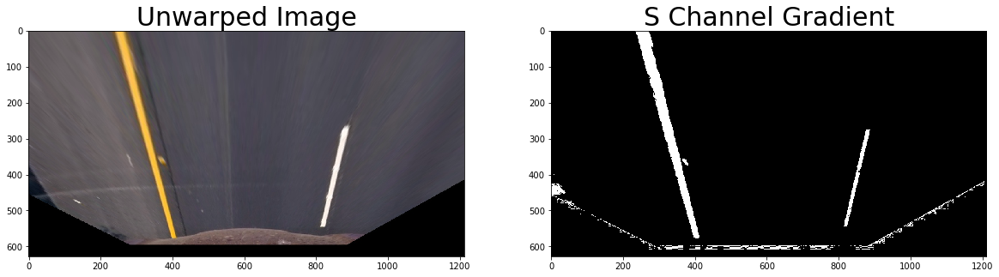

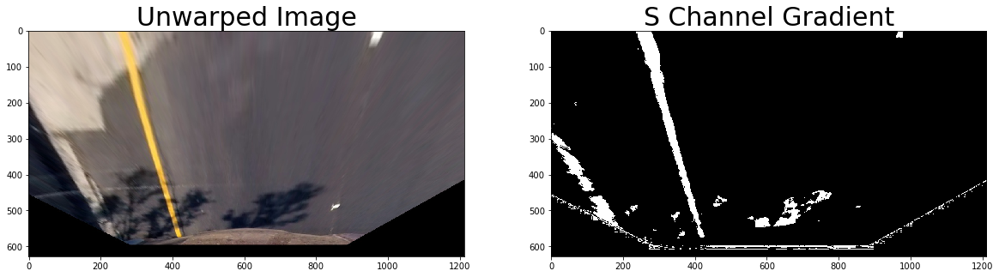

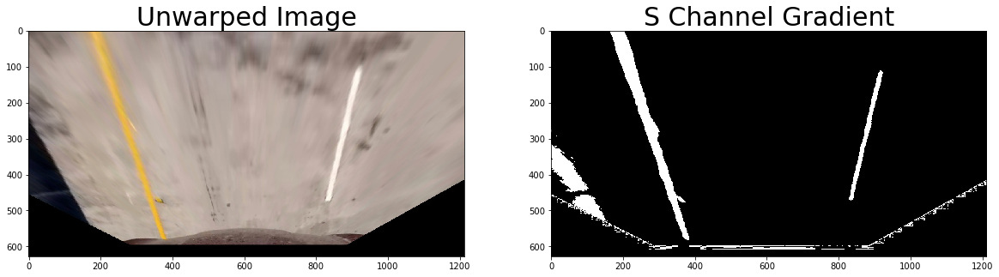

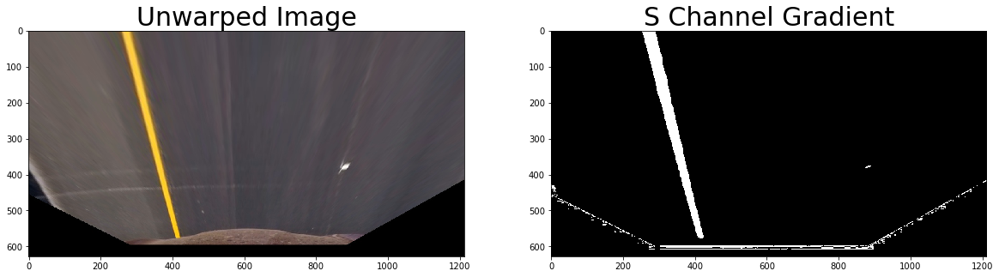

In [11]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    hls_binary = hls_select(unwarp_image, thresh=(100, 255))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(hls_binary, cmap='gray')
    ax2.set_title('S Channel Gradient', fontsize=30)

## Test Color B Channel Threshold

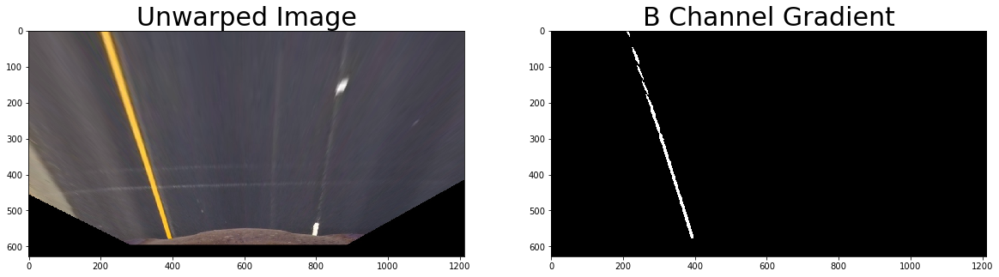

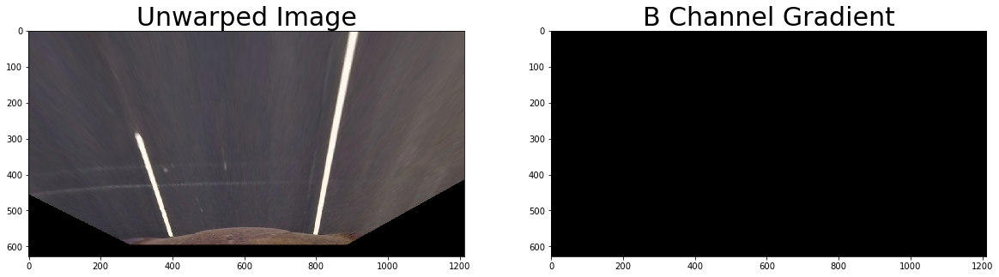

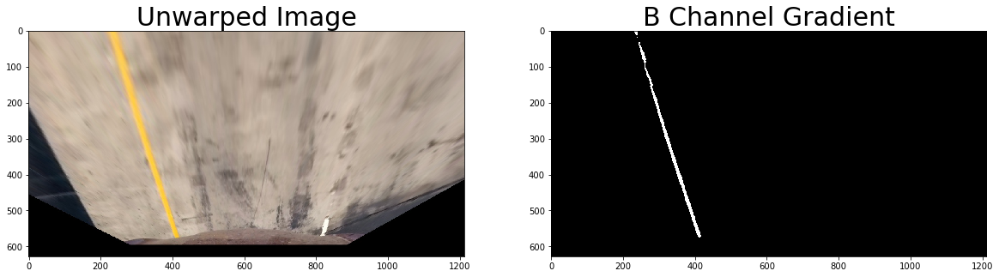

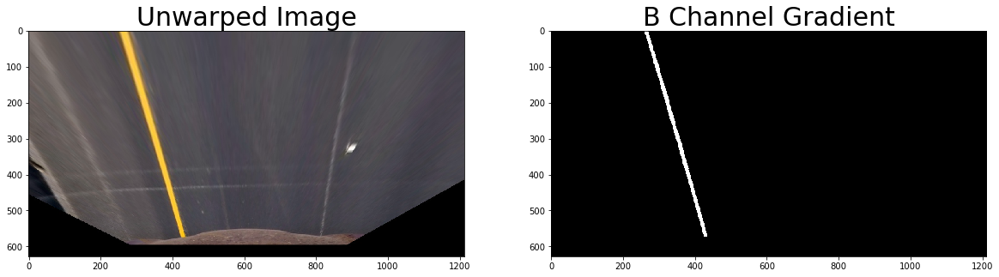

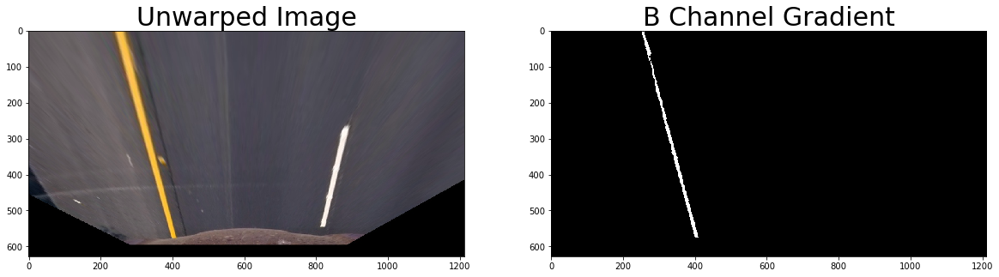

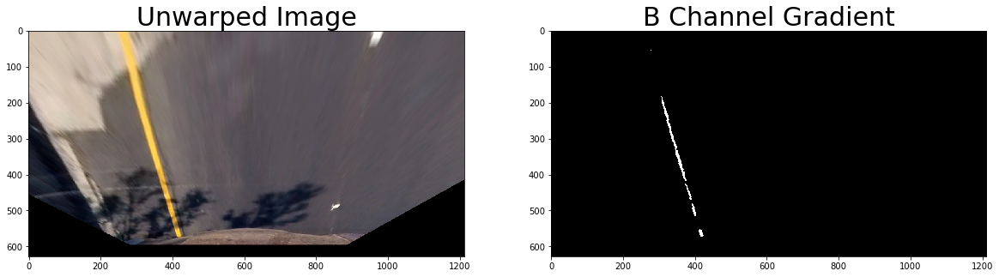

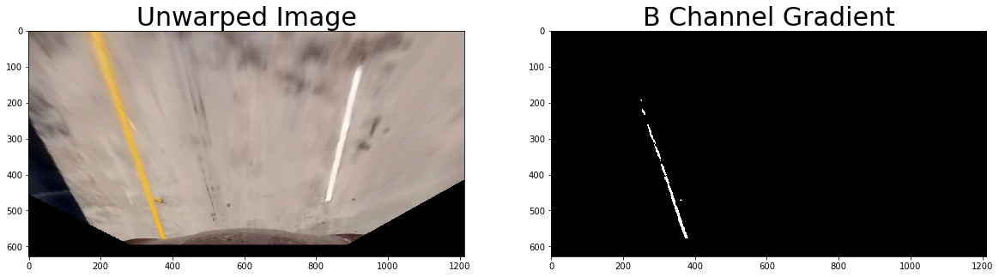

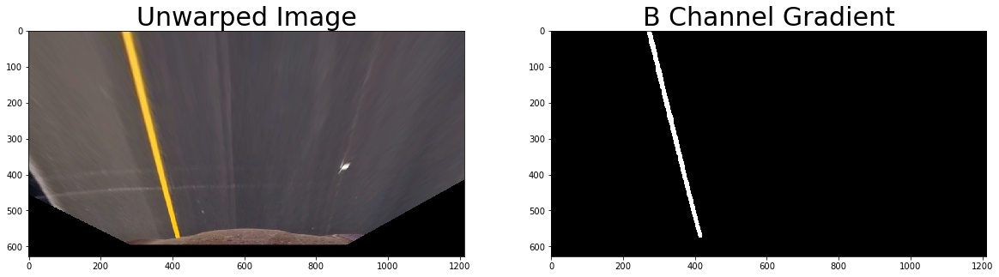

In [16]:
#Surprised to find that the B Channel covering Blue-Yellow in LAB color space detects yellow lanes very well after adjusting thresholds
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    lab_binary = lab_select(unwarp_image, thresh=(190, 255))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(lab_binary, cmap='gray')
    ax2.set_title('B Channel Gradient', fontsize=30)

## Test Combined Binary Image Results

In [17]:
def combined(image):
    ksize = 3
    s_thresh = hls_select(image, thresh=(100, 255))
    b_thresh = lab_select(image, thresh=(190, 255))

    gradx = abs_sobel_thresh(image, orient='x', kernel_size=ksize, thresh=(15, 210))
    grady = abs_sobel_thresh(image, orient='y', kernel_size=ksize, thresh=(15, 210))
    dir_binary = dir_threshold(image, kernel_size=15, thresh=(0.7, 1.2))
    mag_binary = mag_thresh(image, kernel_size=9, mag_thresh=(50, 200))
    #combined = np.dstack((np.zeros_like(dir_binary), mag_binary, grady, gradx, s_thresh, b_thresh))
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | (s_thresh == 1) | (b_thresh == 1)] = 1
    return combined

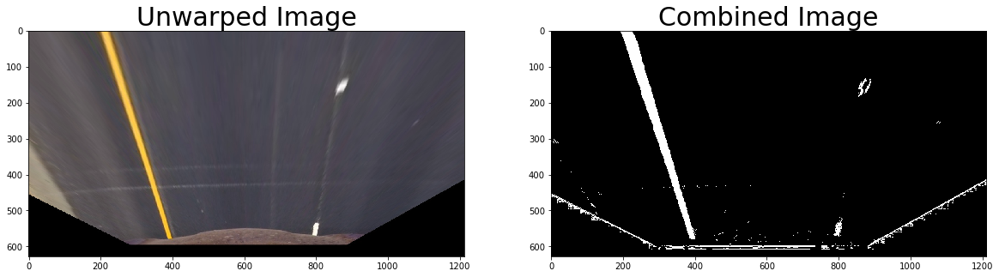

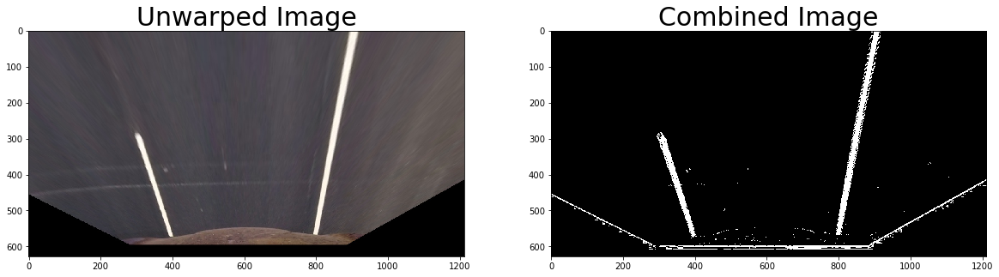

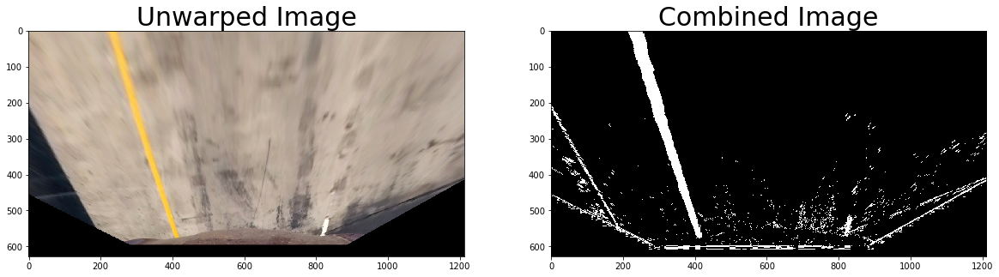

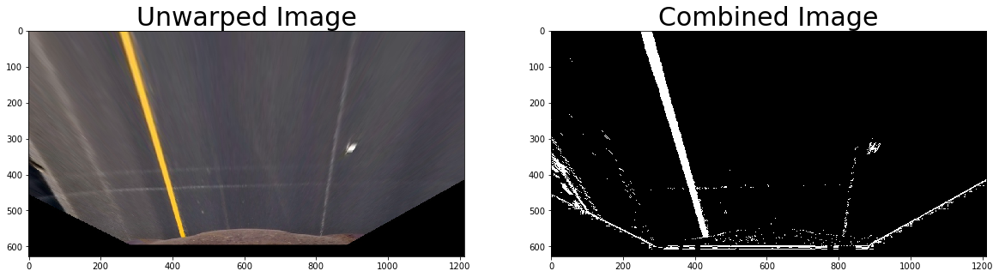

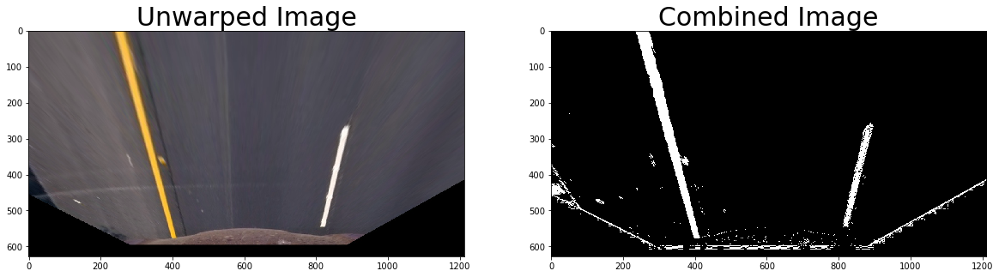

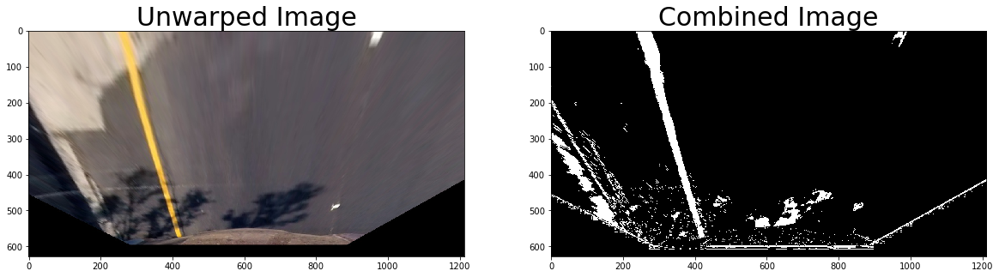

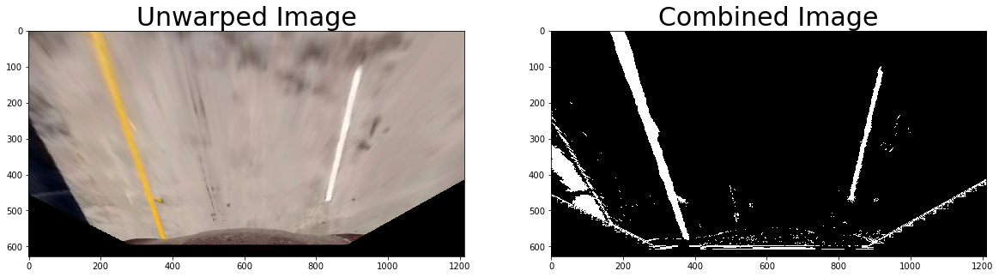

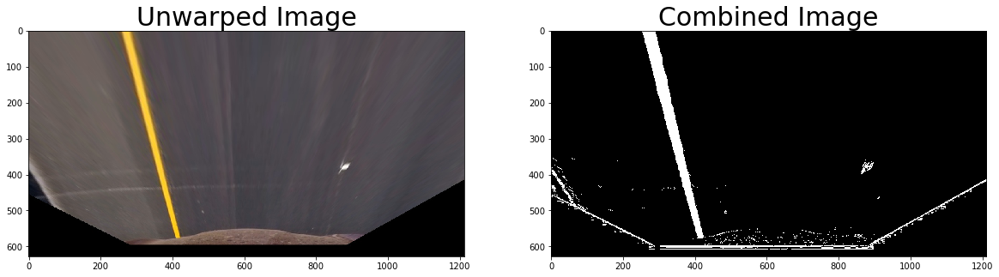

In [18]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    combined_binary = combined(unwarp_image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(combined_binary, cmap='gray')
    ax2.set_title('Combined Image', fontsize=30)

## Pipeline Test - Putting it all together - Undistort, Unwarp and Combined Threshold Images

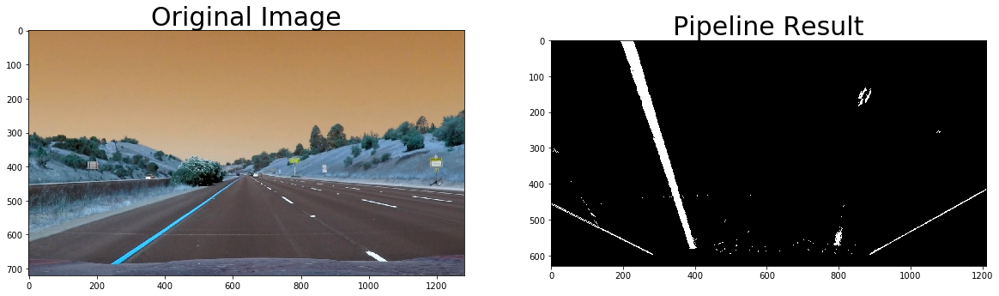

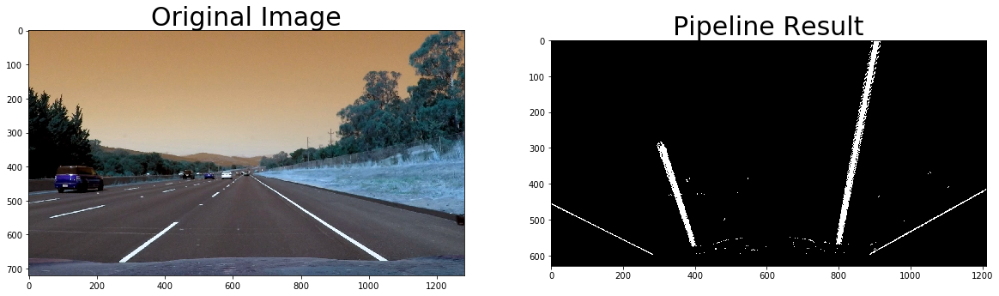

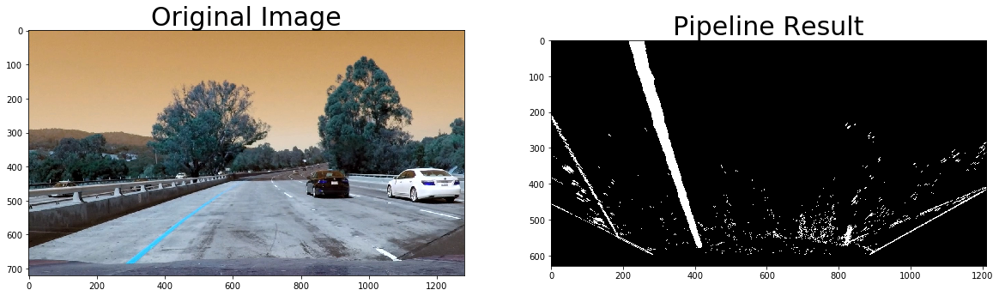

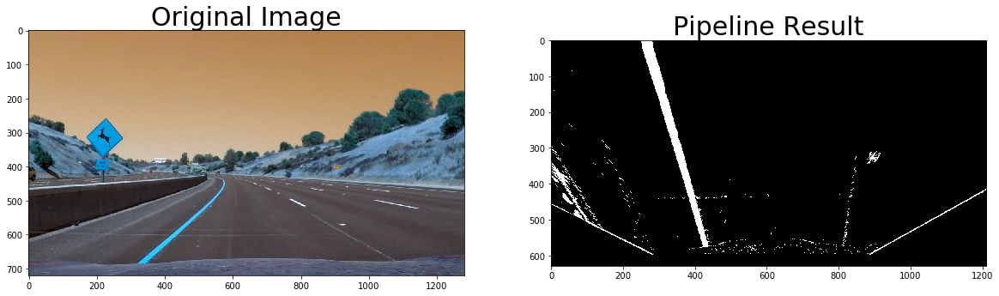

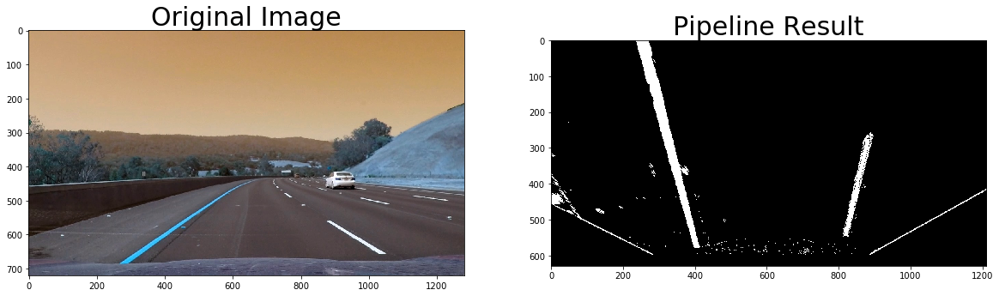

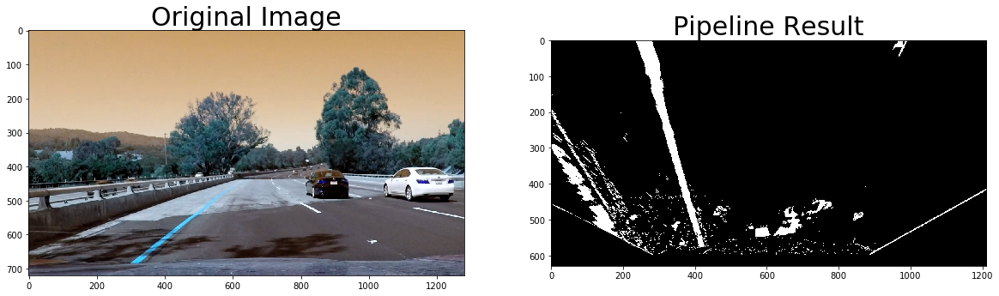

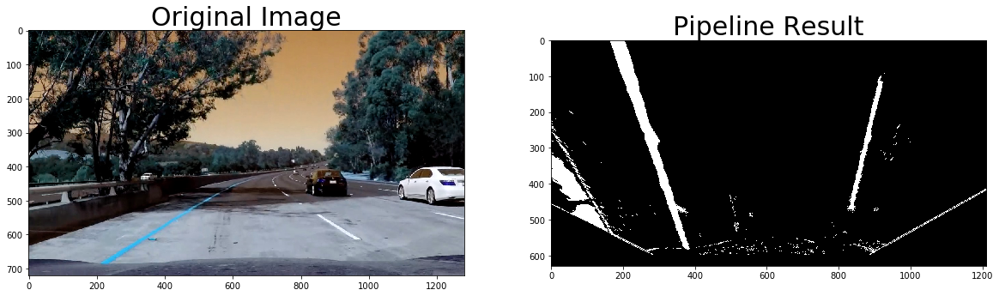

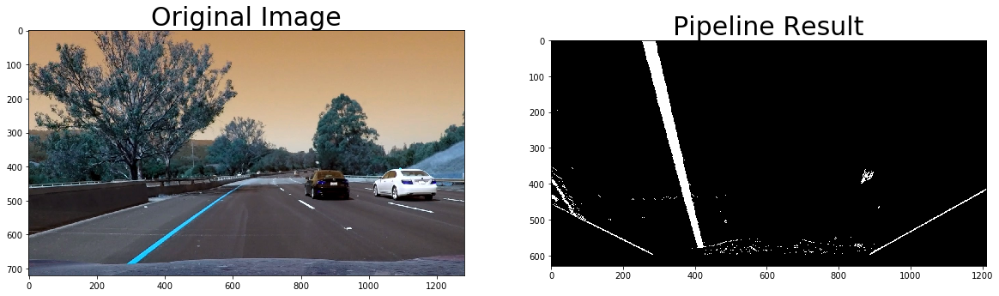

In [20]:
def pipeline(input_image):
    img = undistort_image(input_image)
    img, M, Minv = warp_image(img, src, dst)
    img = combined(img)
    return img

# Make a list of example images
starting_test_images = glob.glob('./test_images/*.jpg')

for idx, fname in enumerate(starting_test_images):
    # Run the Absolute Threshold function
    input_image = cv2.imread(fname)
    result = pipeline(input_image)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(input_image, cmap='gray')
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(result, cmap='gray')
    ax2.set_title('Pipeline Result', fontsize=30)